# embedding topology analysis

Use the observed loop in epithelial cells of gut_dev_Huycke dataset.  
This loop reveals cell cycle information back in gene expression matrix.

In [1]:
%load_ext autoreload
%autoreload 2

# Basic setup

In [2]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import time
from pathlib import Path
import torch
import concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
import matplotlib as mpl
from scipy import sparse

from matplotlib import font_manager, rcParams
custom_rc = {
    'font.family': 'DejaVu Sans',
}

# mpl.rcParams['svg.fonttype'] = 'none'
# mpl.rcParams['pdf.fonttype'] = 42

In [3]:
proj_name = "gut_dev_Huycke"
file_name = "gut_dev_Huycke_Jul17-1902"
file_suffix = time.strftime('%b%d-%H%M')

save_dir = Path(f"../save/{proj_name}-{file_suffix}")
save_dir.mkdir(parents=True, exist_ok=True)
# save_dir = Path(f"../save/{proj_name}-Aug04-0015")

data_dir = Path(f"../data/{proj_name}")
data_dir.mkdir(parents=True, exist_ok=True)

seed = 0
ccd.ul.set_seed(seed)

In [15]:
# load the data
adata = sc.read_h5ad(data_dir / f"{file_name}_final.h5ad")

In [22]:
# Define color palette for broad_cell_type
_, _, celltype_pal = ccd.pl.get_color_mapping(adata, 'cell_type', pal='Set1', seed=seed)
_, _, broad_celltype_pal = ccd.pl.get_color_mapping(adata, 'broad_cell_type', pal='Set1', seed=seed)
_, _, phase_pal = ccd.pl.get_color_mapping(adata, 'phase', pal='Set1', seed=seed)

pal = {"cell_type": celltype_pal,
    "broad_cell_type": broad_celltype_pal,
    'phase': phase_pal,}

In [ ]:
# basis = 'concord_hcl'
basis = 'concord_knn'
show_basis = basis + '_UMAP'
show_cols = ['broad_cell_type', 'cell_type', 'phase']
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=6, point_size=1, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_embedding.pdf"
)

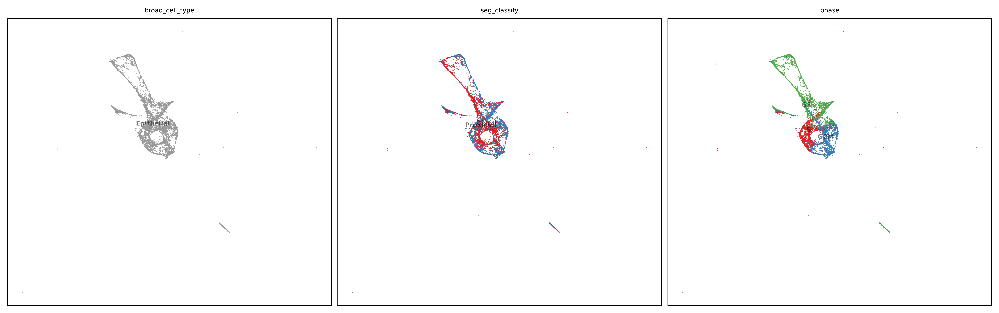

In [27]:
# plot UMAP of the cell subset in the concord_knn embedding
cell_type_subset = 'Epithelial'
adata_subset = adata[adata.obs['broad_cell_type'] == cell_type_subset].copy()

basis = 'concord_knn'
show_basis = basis + '_UMAP'
show_cols = ['broad_cell_type', 'seg_classify', 'phase']       
ccd.pl.plot_embedding(
    adata_subset, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=6, point_size=3, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_embedding.pdf"
)

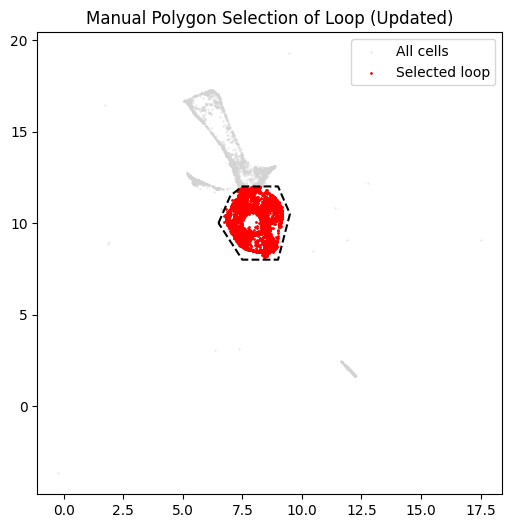

In [40]:
from matplotlib.path import Path
import matplotlib.pyplot as plt
import numpy as np

# Step 1: Coordinates (e.g., UMAP)
X = adata_subset.obsm['concord_knn_UMAP']

# Step 2: Define updated polygon
polygon = np.array([
    [6.5, 10.0],
    [7.0, 11.5],
    [7.5, 12.0],
    [9.0, 12.0],
    [9.5, 10.5],
    [9.0, 8.0],
    [7.5, 8.0],
    [6.5, 10.0]  # closing the loop
])
path = Path(polygon)

# Step 3: Find points inside polygon
mask = path.contains_points(X)
adata_subset_loop = adata_subset[mask].copy()

# Step 4: Plot result
plt.figure(figsize=(6, 6))
plt.scatter(X[:, 0], X[:, 1], c='lightgray', s=0.1, label='All cells')
plt.scatter(X[mask, 0], X[mask, 1], c='red', s=1, label='Selected loop')
plt.plot(polygon[:, 0], polygon[:, 1], 'k--')  # draw loop
plt.legend()
plt.title("Manual Polygon Selection of Loop (Updated)")

# save the selected loop figure in the save directory
plt.savefig(save_dir / f"{file_name}_{cell_type_subset}_loop_selection.pdf", bbox_inches='tight', dpi=300)

plt.show()


In [41]:
# save adata_subset_loop to a h5ad file
adata_subset_loop.write_h5ad(save_dir / f"{file_name}_{cell_type_subset}_loop.h5ad")

In [ ]:
ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, show_cols, figsize=(13,4), dpi=600, ncols=3, font_size=12, point_size=20, legend_loc="on data",
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_embedding.pdf",
)

In [43]:
adata_subset_loop.obs['phase'].value_counts()

phase
G2M    1929
S      1185
G1      404
Name: count, dtype: int64

In [ ]:
cell_type_subset = 'Epithelial'
# adata_subset_loop = sc.read_h5ad( save_dir / f"{file_name}_{cell_type_subset}_loop.h5ad")
adata_subset_loop = sc.read_h5ad( Path('../save/gut_dev_Huycke-Aug04-2332') / f"{file_name}_{cell_type_subset}_loop.h5ad")

----

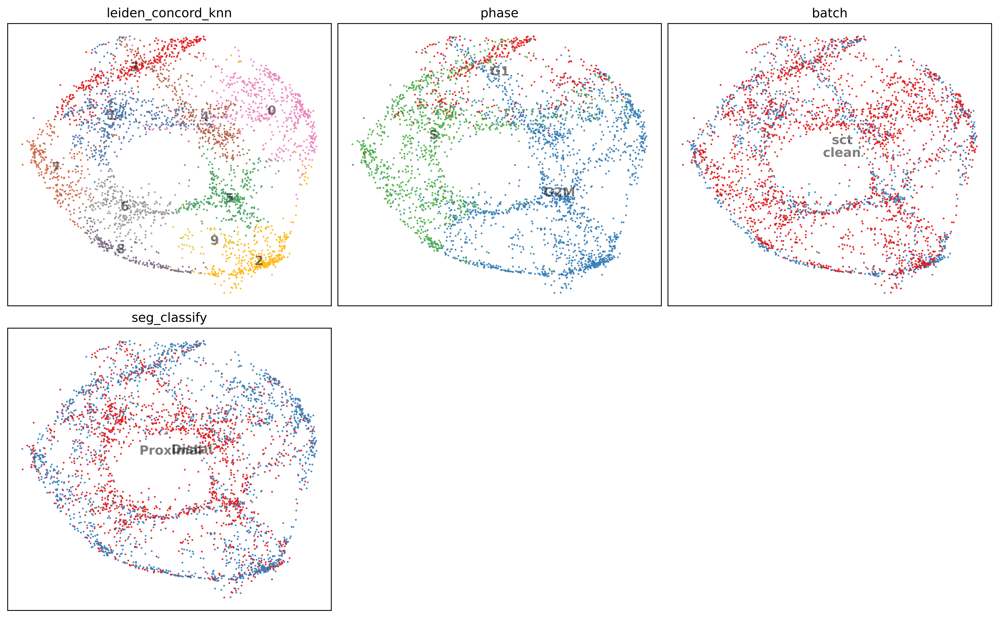

In [90]:
import scanpy as sc

# Step 1: Create a neighbor graph from the latent space you want to use
sc.pp.neighbors(adata_subset_loop, use_rep='concord_knn', n_neighbors=15)

# Step 2: Run Leiden clustering
sc.tl.leiden(adata_subset_loop, resolution=0.5, key_added='leiden_concord_knn')

# Step 3: Plot the Leiden clusters on the UMAP
ccd.pl.plot_embedding(
    adata_subset_loop, 
    show_basis, 
    color_by = ['leiden_concord_knn', 'phase', 'batch',
                'seg_classify'], 
    figsize=(13,8), 
    dpi=600, 
    ncols=3, 
    font_size=12, 
    point_size=12, 
    legend_loc="on data",
    save_path=save_dir / f"{file_name}_{show_basis}_endothelial_loop_leiden_embedding.pdf",
)

In [88]:
# Step 1: Define custom mapping
# Replace keys with original Leiden cluster labels and values with desired labels based on loop_order
leiden_loop_map = {
    '3': 'loopA',
    '7': 'loopA',
    '8': 'loopA',
    '2': 'loopA',
    '0': 'loopA',     
    '1': 'loopB',
    '6': 'loopB',
    '9': 'loopB',
    '5': 'loopB',
    '4': 'loopB',
}

leiden_loop_clusters_map = {
    '3': 'loopA-1',
    '7': 'loopA-2',
    '8': 'loopA-3',
    '2': 'loopA-4',
    '0': 'loopA-5',
    '1': 'loopB-1',
    '6': 'loopB-2',
    '9': 'loopB-3',
    '5': 'loopB-4',
    '4': 'loopB-5',
    # ... continue as needed
}

# Step 2: Apply the mapping
adata_subset_loop.obs['leiden_loop'] = (
    adata_subset_loop.obs['leiden_concord_knn'].map(leiden_loop_map)
)

adata_subset_loop.obs['leiden_loop_clusters'] = (
    adata_subset_loop.obs['leiden_concord_knn'].map(leiden_loop_clusters_map)
)

# Step 3: Set as categorical with order (optional, for plotting consistency)
custom_order = pd.unique(adata_subset_loop.obs['leiden_loop_clusters']).tolist()
custom_order.sort()

adata_subset_loop.obs['leiden_loop_clusters'] = pd.Categorical(
    adata_subset_loop.obs['leiden_loop_clusters'],
    categories=custom_order,
    ordered=True
)

_, _, leiden_loop_pal = ccd.pl.get_color_mapping(adata_subset_loop, 'leiden_loop', pal='Set1', seed=seed)
_, _, leiden_loop_clusters_pal = ccd.pl.get_color_mapping(adata_subset_loop, 'leiden_loop_clusters', pal='Set1', seed=seed)
pal = {"cell_type": celltype_pal,
    "broad_cell_type": broad_celltype_pal,
    'phase': phase_pal,
    'leiden_loop': leiden_loop_pal,
    'leiden_loop_clusters': leiden_loop_clusters_pal}

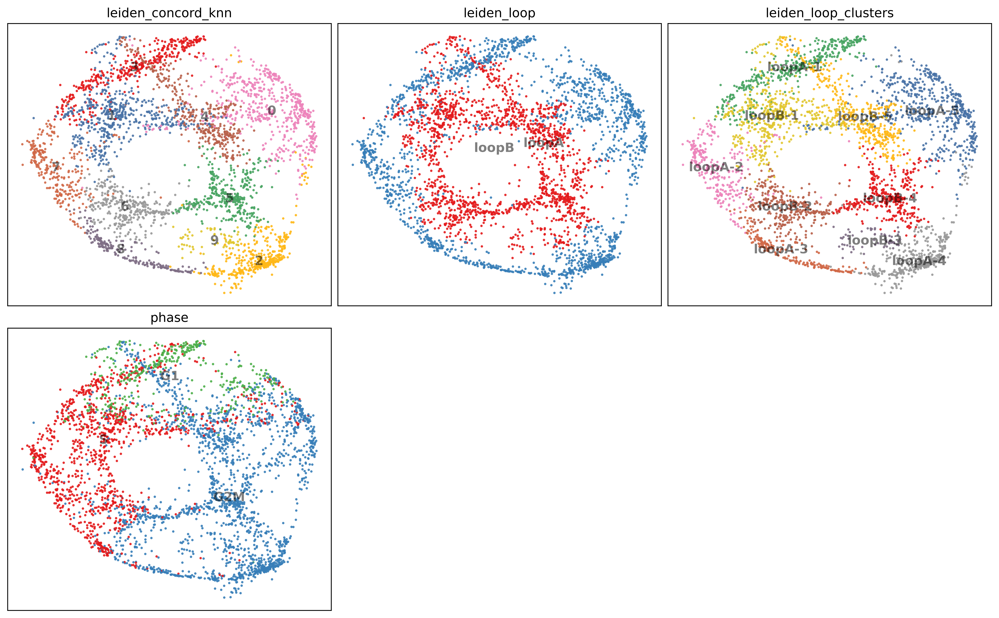

In [89]:
# Step 4: Plot the Leiden clusters on the UMAP
basis = 'concord_knn'
show_basis = basis + '_UMAP'

ccd.pl.plot_embedding(
    adata_subset_loop, 
    show_basis, 
    color_by = ['leiden_concord_knn', 'leiden_loop', 'leiden_loop_clusters', 'phase'], 
    figsize=(13,8), 
    dpi=600, 
    ncols=3, 
    font_size=12, 
    point_size=20, 
    pal=pal,
    legend_loc="on data",
    save_path=save_dir / f"{file_name}_{cell_type_subset}_leiden_clusters.pdf",
)

In [65]:
color_by = 'leiden_loop_clusters'

ccd.pl.plot_embedding_3d(
    adata_subset_loop, basis='concord_knn_UMAP_3D', color_by=color_by,
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_{color_by}_embedding_3d.html",
    point_size=1, opacity=0.7,
)

concord.plotting.pl_embedding - INFO - 3D plot saved to ../save/gut_dev_Huycke-Aug04-2332/gut_dev_Huycke_Jul17-1902_concord_knn_UMAP_Epithelial_leiden_loop_clusters_embedding_3d_leiden_loop_clusters.html


[Figure({
     'data': [{'hovertemplate': ('leiden_loop_clusters=loopA-3<b' ... 'y}<br>DIM3=%{z}<extra></extra>'),
               'legendgroup': 'loopA-3',
               'marker': {'color': '#ffb817', 'opacity': 0.7, 'size': 1, 'symbol': 'circle'},
               'mode': 'markers',
               'name': 'loopA-3',
               'scene': 'scene',
               'showlegend': True,
               'type': 'scatter3d',
               'x': {'bdata': ('uxvIQOvCzUB4+LxA3FzRQGWTw0Cryr' ... 'BcU81A4tPMQFJByUDTrLlAKI3KQA=='),
                     'dtype': 'f4'},
               'y': {'bdata': ('bE+3QIxjukAvg7ZAmT+3QGnqtkASl7' ... 'CXp7dA95OxQGU4uUD+orZAYUuzQA=='),
                     'dtype': 'f4'},
               'z': {'bdata': ('b/Whv64nor8VbcC/P2mnvzNWrL+jWs' ... '9bOai/vq26vzGHnL+UW8y/3Bizvw=='),
                     'dtype': 'f4'}},
              {'hovertemplate': ('leiden_loop_clusters=loopB-5<b' ... 'y}<br>DIM3=%{z}<extra></extra>'),
               'legendgroup': 'loopB-5',
           

In [59]:
adata_subset_loop.obs['leiden_loop_ordered'].value_counts().sort_index() 

leiden_loop_ordered
loopA-1    387
loopA-2    278
loopA-3    205
loopA-4    412
loopA-5    572
loopB-1    518
loopB-2    334
loopB-3     63
loopB-4    365
loopB-5    384
Name: count, dtype: int64

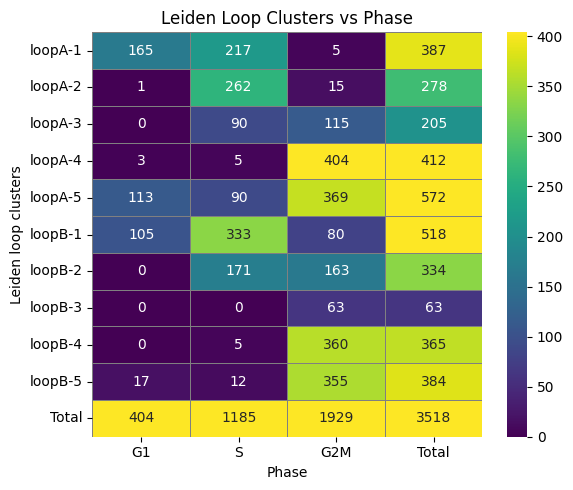

In [67]:
import seaborn as sns, matplotlib.pyplot as plt

phase_order = ['G1', 'S', 'G2M']
adata_subset_loop.obs['phase'] = pd.Categorical(
    adata_subset_loop.obs['phase'], 
    categories=phase_order, 
    ordered=True
)

# Crosstab with totals
crosstab_df = pd.crosstab(
    adata_subset_loop.obs['leiden_loop_clusters'],
    adata_subset_loop.obs['phase'],
    margins=True, margins_name="Total"
)

# Exclude 'Total' row and column for vmax
crosstab_clean = crosstab_df.drop(index="Total", columns="Total")
vmax_val = crosstab_clean.to_numpy().max()

# Plot full table with fixed color scale
plt.figure(figsize=(6, 5))
sns.heatmap(crosstab_df, annot=True, fmt='d', cmap='viridis', cbar=True,
            linewidths=0.5, linecolor='gray', vmin=0, vmax=vmax_val)
plt.title("Leiden Loop Clusters vs Phase")
plt.ylabel("Leiden loop clusters")
plt.xlabel("Phase")
plt.tight_layout()
plt.savefig(save_dir / f"{file_name}_leiden_loop_clusters_phase_crosstab.pdf", dpi=300)
plt.show()
plt.close()


In [68]:
adata_subset_loop.obs['leiden_loop'].value_counts().sort_index() 

leiden_loop
loopA    1854
loopB    1664
Name: count, dtype: int64

----

# order cells by pseudotime

In [76]:
import numpy as np
import pandas as pd

# Step 1: Get UMAP coordinates and loop labels
X_loop = adata_subset_loop.obsm['concord_knn_UMAP']
loop_labels = adata_subset_loop.obs['leiden_loop']

# Step 2: Choose center
center = X_loop.mean(axis=0)  # or np.array([x, y])
X_centered = X_loop - center

# Step 3: Compute base angles in radians
angles = np.arctan2(X_centered[:, 1], X_centered[:, 0])  # [-π, π]
angles = (angles + 2 * np.pi) % (2 * np.pi)  # Convert to [0, 2π]

# Step 4: Apply custom angle shift per loop
angle_shifted = angles.copy()
angle_shifted[loop_labels == 'loopA'] = (angles[loop_labels == 'loopA'] - 5 * np.pi / 12) % (2 * np.pi)
angle_shifted[loop_labels == 'loopB'] = (angles[loop_labels == 'loopB'] - 7 * np.pi / 12) % (2 * np.pi)

# Step 5: Store in .obs
adata_subset_loop.obs['loop_angle'] = angle_shifted

# Step 6: Order cells by angle (loop-wise)
adata_subset_loop.obs['loop_order'] = (
    angle_shifted.argsort().argsort()  # Gives 0 to N-1 ranking
)


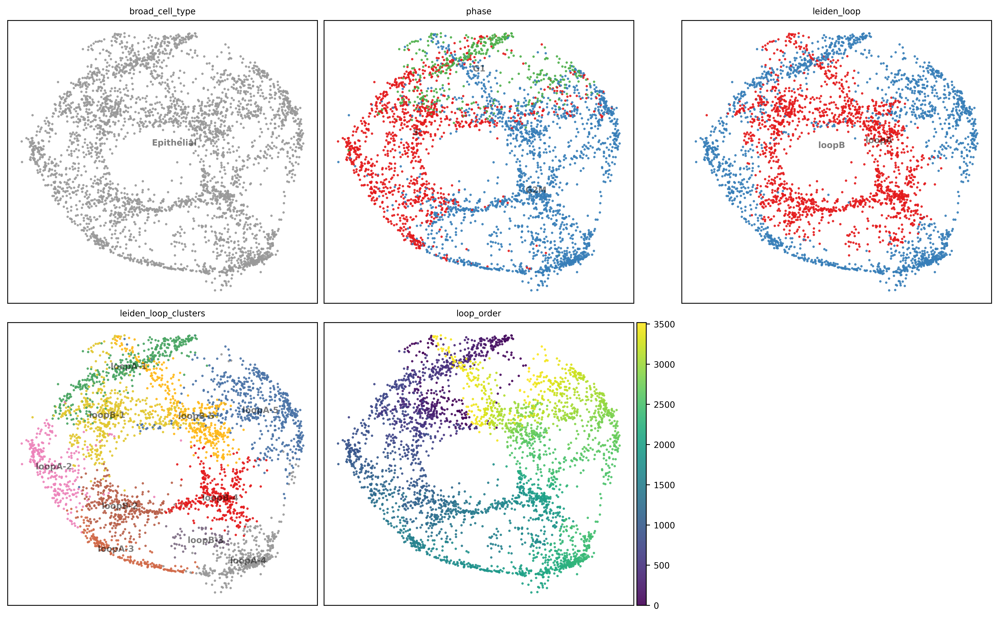

In [77]:
basis = 'concord_knn'
show_basis = basis + '_UMAP'

ccd.pl.plot_embedding(
    adata_subset_loop, show_basis, 
    color_by = ['broad_cell_type', 'phase',  'leiden_loop', 'leiden_loop_clusters', 'loop_order',] , 
    figsize=(13,8), dpi=600, ncols=3, point_size=20, 
    pal=pal,
    save_path=save_dir / f"{file_name}_{show_basis}_{cell_type_subset}_loop_ordered_embedding.pdf",
)

----

In [78]:
loop_results = {}

for loop_label in adata_subset_loop.obs['leiden_loop'].unique():
    print(f"Running rank_genes_groups for {loop_label}")
    
    adata_loop = adata_subset_loop[adata_subset_loop.obs['leiden_loop'] == loop_label].copy()
    
    sc.tl.rank_genes_groups(
        adata_loop,
        groupby='leiden_loop_clusters',
        method='wilcoxon',
        use_raw=False,
    )
    
    # Store in dict
    loop_results[loop_label] = adata_loop

# Save each loop's results
for loop_label, adata_loop in loop_results.items():
    output_file = save_dir / f"{file_name}_{cell_type_subset}_loop_{loop_label}_rank_genes.h5ad"
    adata_loop.write_h5ad(output_file)
    print(f"Saved {loop_label} results to {output_file}")


Running rank_genes_groups for loopA
Running rank_genes_groups for loopB
Saved loopA results to ../save/gut_dev_Huycke-Aug05-2132/gut_dev_Huycke_Jul17-1902_Epithelial_loop_loopA_rank_genes.h5ad
Saved loopB results to ../save/gut_dev_Huycke-Aug05-2132/gut_dev_Huycke_Jul17-1902_Epithelial_loop_loopB_rank_genes.h5ad


In [79]:
loop_results

{'loopA': AnnData object with n_obs × n_vars = 1854 × 18701
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'RNA_snn_res.0.5', 'seurat_clusters', 'PercentMito', 'RNA_snn_res.1', 'LaneID', 'MULTI', 'SinDubNeg', 'Age', 'Mouse', 'SegPos', 'RNA_snn_res.5', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.1', 'Age_Mouse', 'Age_Pos', 'CellType_Coarse', 'SCT_snn_res.0.8', 'Classification', 'MouseAge', 'SegmentPos', 'MouseAge_combined', 'batch', 'mes_subtype', 'cell_type', 'epi_subtype', 'mes_BN', 'tcf_signaling_response_wnt_score', 'epi_wnt_group', 'MitoFraction', 'seg_classify', 'S_score', 'G2M_score', 'phase', 'broad_cell_type', 'stage', 'leiden_global_Concord', 'mac_subtype', 'leiden_concord_knn', 'leiden_loop', 'leiden_loop_clusters', 'loop_angle', 'loop_order'
     var: 'gene_short_name'
     uns: 'LaneID_colors', 'MouseAge_combined_colors', 'batch_colors', 'broad_cell_type_colors', 'cell_type_colors', 'epi_subtype_colors', 'leiden_concord_knn', 'leiden_concord_knn_colors', 'leiden_globa

In [12]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Combine DEGs from all loop subsets in loop_results
top_n = 10
combined_degs = []

for loop_label, adata_loop in loop_results.items():
    degs_df = sc.get.rank_genes_groups_df(adata_loop, group=None)
    degs_df["loop"] = loop_label  # Add loop label for traceability

    top_genes_df = (
        degs_df
        .groupby("group")
        .apply(lambda x: x.nsmallest(top_n, "pvals_adj"))
        .reset_index(drop=True)
    )
    
    combined_degs.append(top_genes_df)

# Step 2: Concatenate all top DEGs into one DataFrame
all_degs_df = pd.concat(combined_degs, ignore_index=True)

# Step 3: Get unique top genes across all clusters and loops
top_genes = all_degs_df["names"].unique().tolist()
print(f"{len(top_genes)} unique top DEGs extracted across all clusters in all loops.")

# Step 2: Subset AnnData and compute z-score
adata_degs = adata_subset_loop[:, top_genes].copy()
X = adata_degs.X.toarray() if hasattr(adata_degs.X, "toarray") else adata_degs.X
adata_degs.layers["zscore"] = zscore(X, axis=0)

# Step 3: Order cells by leiden_loop_clusters
adata_degs.obs["leiden_order"] = adata_degs.obs["leiden_loop_clusters"].cat.codes
adata_degs = adata_degs[adata_degs.obs.sort_values("leiden_order").index].copy()

# Step 4: Use predefined peak-sorting function on zscore matrix
# Prepare adata_degs.obsm["zscore"] for function input
adata_degs.obsm["zscore"] = adata_degs.layers["zscore"]
loop_path = np.argsort(adata_degs.obs["leiden_order"].values)

sorted_data, _, _, sorted_columns = ccd.ul.sort_and_smooth_signal_along_path(
    adata_degs,
    signal_key="zscore",
    path=loop_path,
    sigma=2
)

# Step 5: Reorder genes in AnnData object
adata_degs = adata_degs[:, sorted_columns].copy()


49 unique top DEGs extracted across all clusters in all loops.


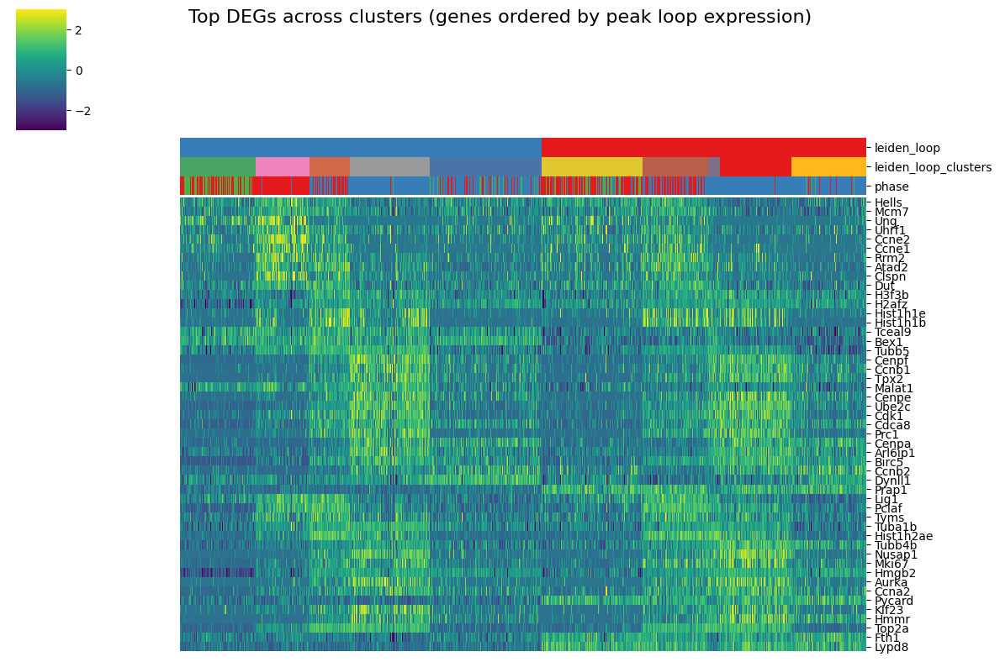

In [ ]:
# adata = sc.read_h5ad(data_dir / f"{file_name}_final.h5ad")
# _, _, celltype_pal = ccd.pl.get_color_mapping(adata, 'cell_type', pal='Set1', seed=seed)
# _, _, broad_celltype_pal = ccd.pl.get_color_mapping(adata, 'broad_cell_type', pal='Set1', seed=seed)
# _, _, phase_pal = ccd.pl.get_color_mapping(adata, 'phase', pal='Set1', seed=seed)
# _, _, leiden_loop_pal = ccd.pl.get_color_mapping(adata_subset_loop, 'leiden_loop', pal='Set1', seed=seed)
# _, _, leiden_loop_clusters_pal = ccd.pl.get_color_mapping(adata_subset_loop, 'leiden_loop_clusters', pal='Set1', seed=seed)
# pal = {"cell_type": celltype_pal,
#     "broad_cell_type": broad_celltype_pal,
#     'phase': phase_pal,
#     'leiden_loop': leiden_loop_pal,
#     'leiden_loop_clusters': leiden_loop_clusters_pal}

# Step 7: Plot
with plt.rc_context(rc=custom_rc):
    ccd.pl.heatmap_with_annotations(
        adata=adata_degs,
        val="zscore",
        transpose=True,
        obs_keys=["leiden_loop","leiden_loop_clusters", "phase"],
        pal={
            "leiden_loop": leiden_loop_pal,
            "leiden_loop_clusters": leiden_loop_clusters_pal,
            "phase": phase_pal
        },
        use_clustermap=True,
        cluster_rows=False,
        cluster_cols=False,
        cmap=sns.color_palette("viridis", as_cmap=True),
        row_scale=False,
        clip_limits=(-3, 3),
        rasterize=True,
        title="Top DEGs across clusters (genes ordered by peak loop expression)",
        figsize=(12, 8),
        save_path=save_dir / f"{proj_name}_top_degs_heatmap.pdf",
        show=True
    )

In [96]:
# save the genes into a file
with open(save_dir / f"{proj_name}_top_degs.txt", "w") as f:
    f.write("\n".join(top_genes))
print(f"Top DEGs saved to {save_dir / f'{proj_name}_top_degs_.txt'}")


Top DEGs saved to ../save/gut_dev_Huycke-Aug04-2332/gut_dev_Huycke_top_degs_.txt


In [97]:
# save the adata to the same h5ad file
adata_subset_loop.write_h5ad(save_dir / f"{file_name}_{cell_type_subset}_loop.h5ad")

----

# plot cellxgene heatmap for each loop

74 unique top DEGs extracted across all clusters in all loops.
Top DEGs for loopA saved to ../save/gut_dev_Huycke-Aug05-2132/gut_dev_Huycke_loopA_top_degs.txt
66 unique top DEGs extracted across all clusters in all loops.
Top DEGs for loopB saved to ../save/gut_dev_Huycke-Aug05-2132/gut_dev_Huycke_loopB_top_degs.txt


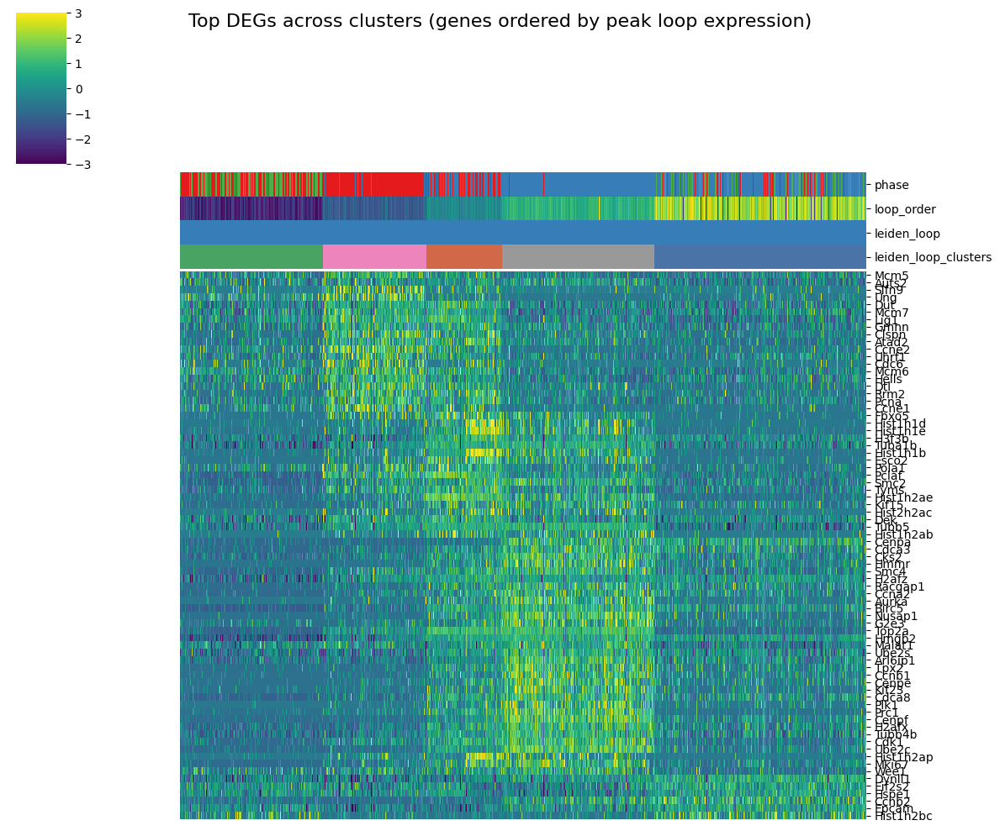

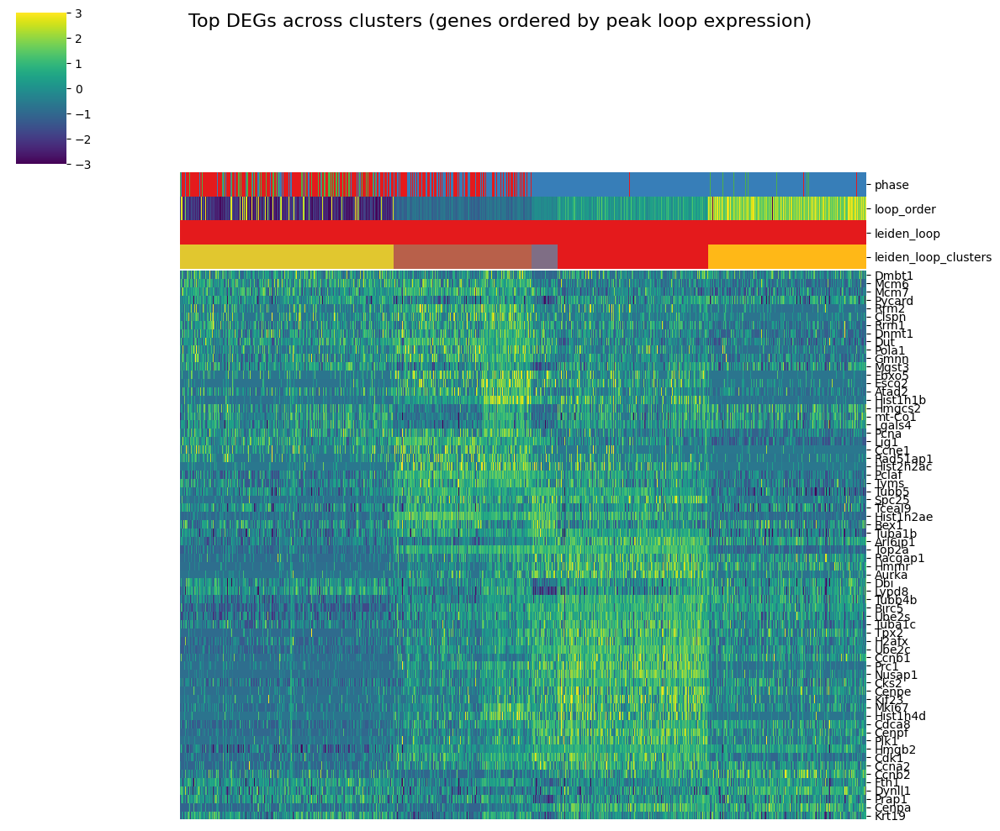

In [92]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Combine DEGs from all loop subsets in loop_results
top_n = 20
combined_degs = []

for loop_label, adata_loop in loop_results.items():
    degs_df = sc.get.rank_genes_groups_df(adata_loop, group=None)
    degs_df["loop"] = loop_label  # Add loop label for traceability

    top_genes_df = (
        degs_df
        .groupby("group")
        .apply(lambda x: x.nsmallest(top_n, "pvals_adj"))
        .reset_index(drop=True)
    )

    # Step 3: Get unique top genes across all clusters and loops
    top_genes = top_genes_df["names"].unique().tolist()
    print(f"{len(top_genes)} unique top DEGs extracted across all clusters in all loops.")

    # Step 2: Subset AnnData and compute z-score
    adata_degs = adata_loop[:, top_genes].copy()
    X = adata_degs.X.toarray() if hasattr(adata_degs.X, "toarray") else adata_degs.X
    adata_degs.layers["zscore"] = zscore(X, axis=0)

    # Step 3: Order cells
    # Base on leiden_loop_clusters
    adata_degs.obs["sort_key"] = adata_degs.obs["leiden_loop_clusters"].cat.codes

    # Based on leiden_loop_clusters and loop_order
    # adata_degs.obs["leiden_order"] = adata_degs.obs["leiden_loop_clusters"].cat.codes
    # adata_degs.obs["sort_key"] = adata_degs.obs["leiden_order"] + adata_degs.obs["loop_order"] * 1e-4

    # # Based on loop_order
    # adata_degs.obs["sort_key"] = adata_degs.obs["loop_order"]

    adata_degs = adata_degs[adata_degs.obs.sort_values("sort_key").index].copy()

    # Step 4: Use predefined peak-sorting function on zscore matrix
    # Prepare adata_degs.obsm["zscore"] for function input
    adata_degs.obsm["zscore"] = adata_degs.layers["zscore"]
    loop_path = np.argsort(adata_degs.obs["sort_key"].values)

    sorted_data, _, _, sorted_columns = ccd.ul.sort_and_smooth_signal_along_path(
        adata_degs,
        signal_key="zscore",
        path=loop_path,
        sigma=2
    )

    # Step 5: Reorder genes in AnnData object
    adata_degs = adata_degs[:, sorted_columns].copy()

    # Step 6: Plot
    with plt.rc_context(rc=custom_rc):
        ccd.pl.heatmap_with_annotations(
            adata=adata_degs,
            val="zscore",
            transpose=True,
            obs_keys=["phase", "loop_order","leiden_loop","leiden_loop_clusters", ],
            pal={
                "leiden_loop": leiden_loop_pal,
                "leiden_loop_clusters": leiden_loop_clusters_pal,
                "phase": phase_pal
            },
            use_clustermap=True,
            cluster_rows=False,
            cluster_cols=False,
            cmap=sns.color_palette("viridis", as_cmap=True),
            row_scale=False,
            clip_limits=(-3, 3),
            rasterize=True,
            title="Top DEGs across clusters (genes ordered by peak loop expression)",
            figsize=(12, 10),
            save_path=save_dir / f"{proj_name}_{loop_label}_top_degs_heatmap_2.pdf",
            show=True
        )

    # save the genes into a file
    with open(save_dir / f"{proj_name}_{loop_label}_top_degs.txt", "w") as f:
        f.write("\n".join(top_genes))
    print(f"Top DEGs for {loop_label} saved to {save_dir / f'{proj_name}_{loop_label}_top_degs.txt'}")

# deg analysis between loop A and loop B

In [21]:
adata_subset_loop.obs['leiden_loop'].value_counts()

leiden_loop
loopA    1854
loopB    1664
Name: count, dtype: int64

In [22]:
import scanpy as sc

sc.tl.rank_genes_groups(
    adata_subset_loop, 
    groupby='leiden_loop', 
    method='wilcoxon', 
    use_raw=False
)

20 top DEGs extracted across leiden_loop clusters.


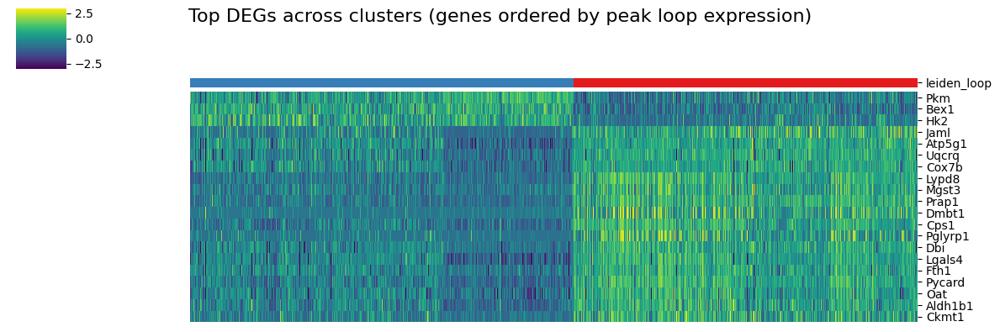

In [28]:
import scanpy as sc
import numpy as np
import pandas as pd
from scipy.stats import zscore
import seaborn as sns
import matplotlib.pyplot as plt

# Step 1: Extract top N DEGs per leiden cluster
degs_df = sc.get.rank_genes_groups_df(adata_subset_loop, group=None)
top_n = 20
top_genes = (
    degs_df
    .groupby("group")
    .apply(lambda x: x.nsmallest(top_n, "pvals_adj"))
    .reset_index(drop=True)["names"]
    .unique()
    .tolist()
)
print(f"{len(top_genes)} top DEGs extracted across leiden_loop clusters.")

# Step 2: Subset AnnData and compute z-score
adata_degs = adata_subset_loop[:, top_genes].copy()
X = adata_degs.X.toarray() if hasattr(adata_degs.X, "toarray") else adata_degs.X
adata_degs.layers["zscore"] = zscore(X, axis=0)

# Step 3: Order cells by leiden_loop
adata_degs.obs["leiden_order"] = adata_degs.obs["leiden_loop"].cat.codes
adata_degs = adata_degs[adata_degs.obs.sort_values("leiden_order").index].copy()

# Step 4: Use predefined peak-sorting function on zscore matrix
# Prepare adata_degs.obsm["zscore"] for function input
adata_degs.obsm["zscore"] = adata_degs.layers["zscore"]
loop_path = np.argsort(adata_degs.obs["leiden_order"].values)

sorted_data, _, _, sorted_columns = ccd.ul.sort_and_smooth_signal_along_path(
    adata_degs,
    signal_key="zscore",
    path=loop_path,
    sigma=2
)

# Step 5: Reorder genes in AnnData object
adata_degs = adata_degs[:, sorted_columns].copy()

# Step 6: Define palette for clusters
# unique_clusters = adata_degs.obs['leiden_loop'].cat.categories
# palette = sns.color_palette("tab20", len(unique_clusters))
# pal = {"leiden_loop": dict(zip(unique_clusters, palette))}

_, _, leiden_loop_pal = ccd.pl.get_color_mapping(adata_degs, 'leiden_loop', pal='Set1', seed=seed)

# Step 7: Plot
with plt.rc_context(rc=custom_rc):
    ccd.pl.heatmap_with_annotations(
        adata=adata_degs,
        val="zscore",
        transpose=True,
        obs_keys=["leiden_loop"],
        pal={"leiden_loop": leiden_loop_pal},
        use_clustermap=True,
        cluster_rows=False,
        cluster_cols=False,
        cmap=sns.color_palette("viridis", as_cmap=True),
        row_scale=False,
        clip_limits=(-3, 3),
        rasterize=True,
        title="Top DEGs across clusters (genes ordered by peak loop expression)",
        figsize=(12, 4),
        save_path=save_dir / f"{proj_name}_between_loops_top_degs_heatmap.pdf",
        show=True
    )


In [29]:
# save the genes into a file
with open(save_dir / f"{proj_name}_between_loops_top_degs.txt", "w") as f:
    f.write("\n".join(top_genes))
print(f"Top DEGs for {loop_label} saved to {save_dir / f'{proj_name}_between_loops_top_degs.txt'}")

Top DEGs for loopB saved to ../save/gut_dev_Huycke-Aug05-2132/gut_dev_Huycke_between_loops_top_degs.txt


In [31]:
pd.crosstab(
    adata_subset_loop.obs['leiden_loop'],
    adata_subset_loop.obs['seg_classify'],
    margins=True, margins_name="Total"
)

seg_classify,Distal,Proximal,Total
leiden_loop,,,
loopA,1345,509,1854
loopB,551,1113,1664
Total,1896,1622,3518


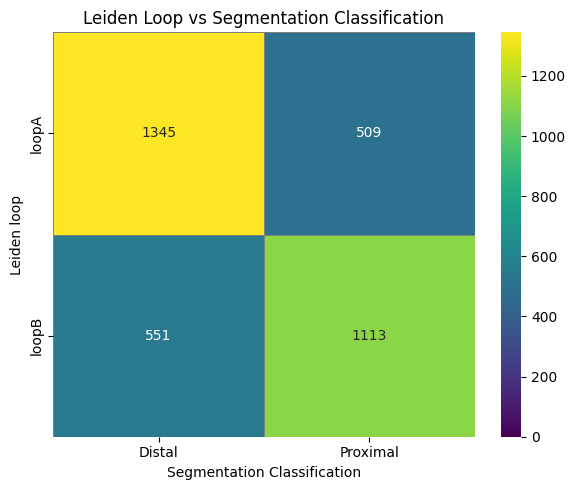

In [34]:
import seaborn as sns, matplotlib.pyplot as plt

# Crosstab with totals
crosstab_df = pd.crosstab(
    adata_subset_loop.obs['leiden_loop'],
    adata_subset_loop.obs['seg_classify'],
    margins=False,
)

# Exclude 'Total' row and column for vmax
vmax_val = crosstab_df.to_numpy().max()

# Plot full table with fixed color scale
plt.figure(figsize=(6, 5))
sns.heatmap(crosstab_df, annot=True, fmt='d', cmap='viridis', cbar=True,
            linewidths=0.5, linecolor='gray', vmin=0, vmax=vmax_val)
plt.title("Leiden Loop vs Segmentation Classification")
plt.ylabel("Leiden loop")
plt.xlabel("Segmentation Classification")
plt.tight_layout()
plt.savefig(save_dir / f"{file_name}_leiden_loop_seg_classify_crosstab.pdf", dpi=300)
plt.show()
plt.close()

In [42]:
top_genes

['Cps1',
 'Prap1',
 'Lypd8',
 'Pycard',
 'Lgals4',
 'Dbi',
 'Uqcrq',
 'Bex1',
 'Mgst3',
 'Dmbt1',
 'Fth1',
 'Jaml',
 'Aldh1b1',
 'Pkm',
 'Oat',
 'Pglyrp1',
 'Ckmt1',
 'Hk2',
 'Cox7b',
 'Atp5g1']

In [ ]:
# plot gene expression for a specific gene across the loops
gene = top_genes
ccd.pl.plot_embedding(
    adata_subset_loop,
    'concord_knn_UMAP',
    color_by=gene,
    figsize=(12, len(top_genes) // 4 * 3), 
    dpi=600, 
    ncols=4, 
    font_size=12, 
    point_size=20,
    save_path=save_dir / f"{file_name}_{cell_type_subset}_loop_deg_between_loops_{gene}_expression.pdf"
)